# Importing libraries

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import os
import folium
import json

In [3]:
# This command propts matplotlib visuals to appear in the notebook 

%matplotlib inline

In [4]:
# Import ".json" file for the U.S. 

country_geo = r'C:\Users\vinor\6.2 Real Estate\02 Data\Original Data\us-states.json'

In [5]:
# Define path
path = r'C:\Users\vinor\Sourcing open data in Phython Task6.1'

In [6]:
# Import data
df_kc_house = pd.read_pickle(os.path.join(path, '02 Data', 'Prepared Data', 'kc_house_data_cleaned.pkl'))

In [7]:
df_kc_house.head()

,Id,Date,Price,Bedrooms,Bathrooms,Sqft_living,Sqft_lot,Floors,Waterfront,View,Condition,Grade,Sqft_Above,Sqft_Basement,Year_Built,Year_Renovated,Zipcode,Latitude,Longitude
0,7129300520,2014-10-13,221900.0,3,1,1180,5650,1,0,0,3,7,1180,0,1970-01-01 00:00:00.000001955,1970-01-01 00:00:00.000000000,98178,47.5112,-122.257
1,6414100192,2014-12-09,538000.0,3,2,2570,7242,2,0,0,3,7,2170,400,1970-01-01 00:00:00.000001951,1970-01-01 00:00:00.000001991,98125,47.7210,-122.319
2,5631500400,2015-02-25,180000.0,2,1,770,10000,1,0,0,3,6,770,0,1970-01-01 00:00:00.000001933,1970-01-01 00:00:00.000000000,98028,47.7379,-122.233
3,2487200875,2014-12-09,604000.0,4,3,1960,5000,1,0,0,5,7,1050,910,1970-01-01 00:00:00.000001965,1970-01-01 00:00:00.000000000,98136,47.5208,-122.393
4,1954400510,2015-02-18,510000.0,3,2,1680,8080,1,0,0,3,8,1680,0,1970-01-01 00:00:00.000001987,1970-01-01 00:00:00.000000000,98074,47.6168,-122.045


In [8]:
# For shape file i have used .json file for the U.S which i have import it in my previous steps.

## Checking whether the data is cleaned.

In [9]:
# Finding Missing Values
df_kc_house.isnull().sum()

Id                0
Date              0
Price             0
Bedrooms          0
Bathrooms         0
Sqft_living       0
Sqft_lot          0
Floors            0
Waterfront        0
View              0
Condition         0
Grade             0
Sqft_Above        0
Sqft_Basement     0
Year_Built        0
Year_Renovated    0
Zipcode           0
Latitude          0
Longitude         0
dtype: int64

In [10]:
# Finding Duplicates
df_dups = df_kc_house[df_kc_house.duplicated()]

In [11]:
df_dups

,Id,Date,Price,Bedrooms,Bathrooms,Sqft_living,Sqft_lot,Floors,Waterfront,View,Condition,Grade,Sqft_Above,Sqft_Basement,Year_Built,Year_Renovated,Zipcode,Latitude,Longitude


In [12]:
# No Missing & Duplicate.

In [13]:
# Check for mixed types.
for col in df_kc_house.columns.tolist():
  weird = (df_kc_house[[col]].map(type) != df_kc_house[[col]].iloc[0].apply(type)).any(axis = 1)
  if len (df_kc_house[weird]) > 0:
    print (col)

In [14]:
# No mixed values.

In [15]:
# checking the variables datatype.
df_kc_house.dtypes

Id                         int64
Date              datetime64[ns]
Price                    float64
Bedrooms                   int64
Bathrooms                  int64
Sqft_living                int64
Sqft_lot                   int64
Floors                     int64
Waterfront                 int64
View                       int64
Condition                  int64
Grade                      int64
Sqft_Above                 int64
Sqft_Basement              int64
Year_Built        datetime64[ns]
Year_Renovated    datetime64[ns]
Zipcode                    int64
Latitude                 float64
Longitude                float64
dtype: object

In [31]:
#current dir
os.chdir(r'C:\\Users\\vinor\\Sourcing open data in Phython Task6.1\\04 Visualisation')
cwd = os.getcwd()
cwd

'C:\\Users\\vinor\\Sourcing open data in Phython Task6.1\\04 Visualisation'

In [59]:
## Sactterplot for Price vs Longitude

<Axes: xlabel='Price', ylabel='Longitude'>

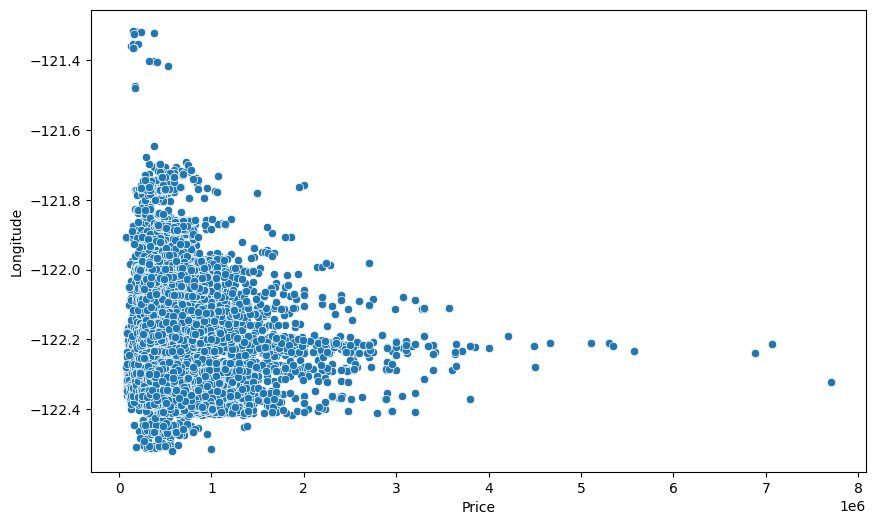

In [32]:
plt.figure(figsize = (10, 6))
sns.scatterplot(x = "Price", y = "Longitude", data = df_kc_house)

In [60]:
## Satterplot for Price vs Latitude.

<Axes: xlabel='Price', ylabel='Latitude'>

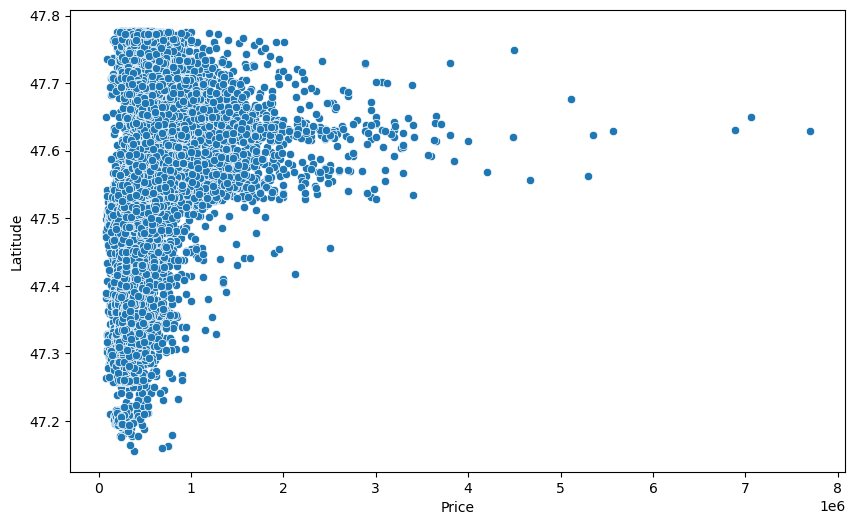

In [33]:
plt.figure(figsize = (10, 6))
sns.scatterplot(x = "Price", y = "Latitude", data = df_kc_house)

<Axes: xlabel='Longitude', ylabel='Latitude'>

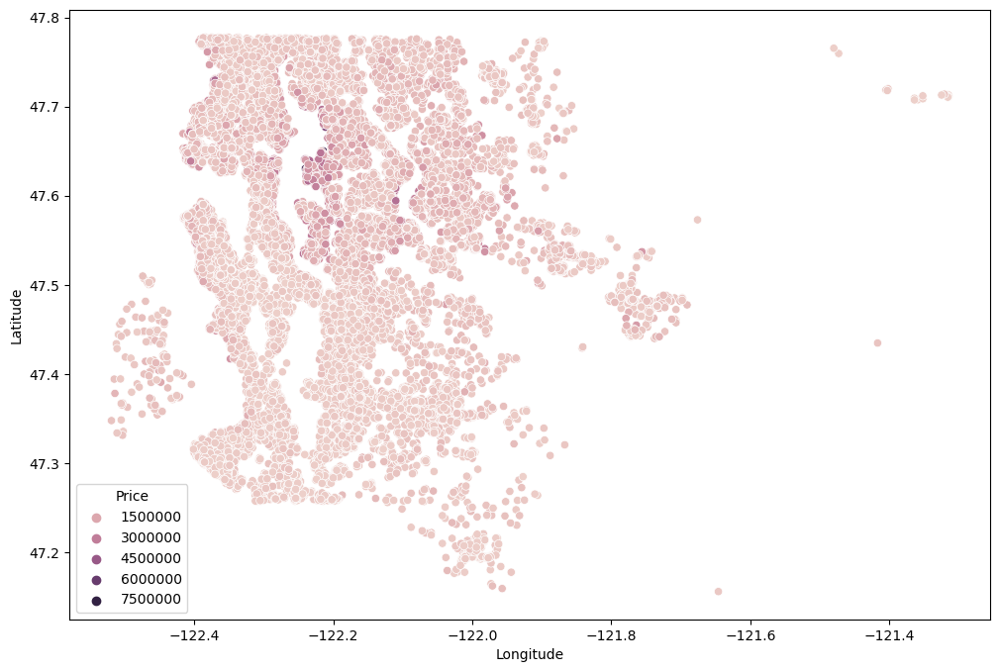

In [34]:
plt.figure(figsize = (12, 8))
sns.scatterplot(x = "Longitude", y = "Latitude", data = df_kc_house, hue = "Price")

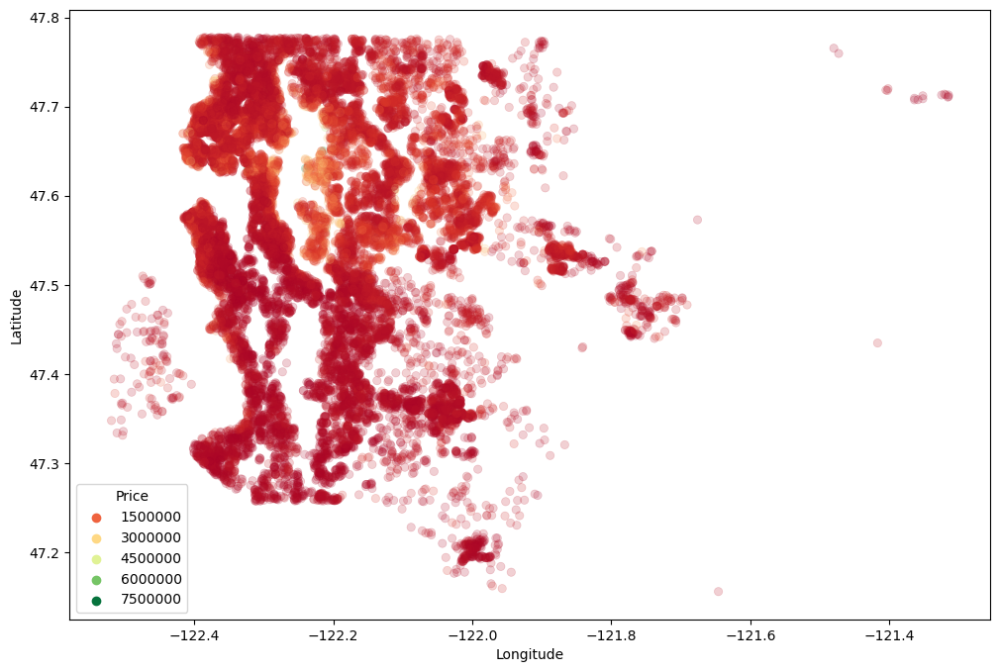

In [35]:
plt.figure(figsize = (12, 8))
sns.scatterplot(x = "Longitude", y = "Latitude", data = df_kc_house, hue = "Price", palette = "RdYlGn", edgecolor = None, alpha = 0.2)
plt.savefig("scatterplot geo price.png") 

In [36]:
df_kc_house.loc[df_kc_house['Price'] < 321950.00000, 'Price category'] = 'Low price'
df_kc_house.loc[(df_kc_house['Price'] >= 321950.00000) & (df_kc_house['Price'] < 645000.00000), 'Price category'] = 'Middle price'
df_kc_house.loc[df_kc_house['Price'] >= 645000.00000, 'Price category'] = 'High price'

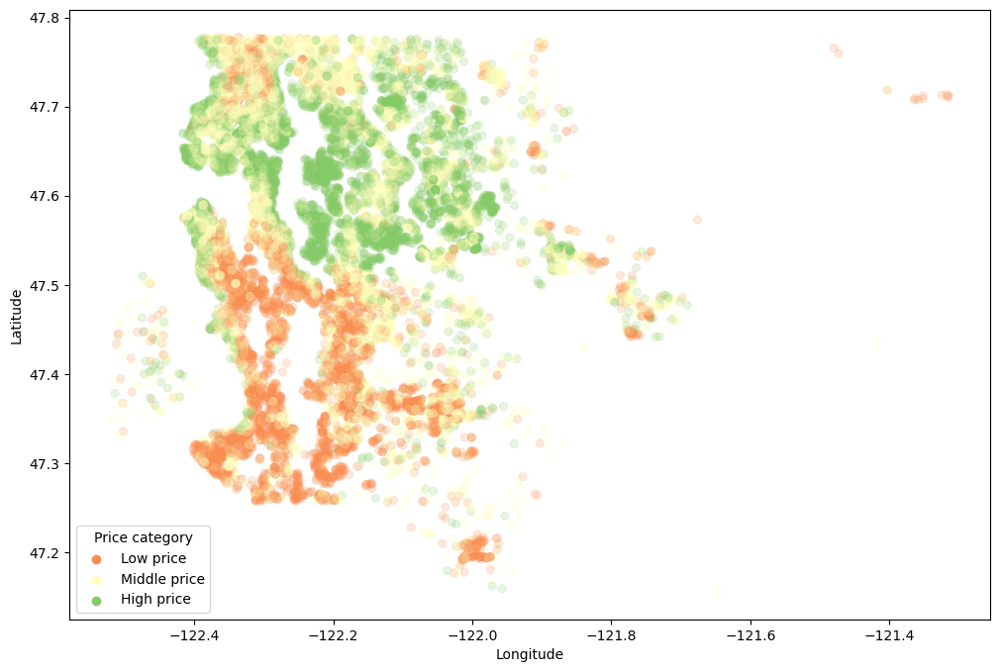

In [37]:
# Set the figure size
plt.figure(figsize=(12, 8))

# Create the scatter plot with price categories encoded by color
sns.scatterplot(x="Longitude", y="Latitude", data=df_kc_house, hue="Price category", palette="RdYlGn", edgecolor=None, alpha=0.2)
plt.savefig("scatterplot geo price by category.png") 
# Show the plot
plt.show()


## Geospatial visualization of Houses sale in King country USA

In [38]:
from folium.plugins import MarkerCluster

# Create a base map centered around the mean latitude and longitude
map = folium.Map(location=[df_kc_house['Latitude'].mean(), df_kc_house['Longitude'].mean()], zoom_start=10)

# Create a MarkerCluster layer
marker_cluster = MarkerCluster().add_to(map)

# Iterate through each data point and add it as a marker to the MarkerCluster layer
for idx, row in df_kc_house.iterrows():
    folium.Marker([row['Latitude'], row['Longitude']],
                  popup=f"Price: {row['Price']}, Bedrooms: {row['Bedrooms']}, Bathrooms: {row['Bathrooms']}",
                  icon=None).add_to(marker_cluster)
    # Add country boundaries
folium.GeoJson(country_geo).add_to(map)

# Display the map
map.save("kc_house_map_count.html")
map


### 	Were there any geographic trends  in property values or sales volume?

In [61]:
# From the geospatial analysis it is clear that the house sale is high in north part, southern part sale is very low.

In [62]:
# In southern part houses saled are low and middle price range. High range price houses are in north part.

In [63]:
# From the analysis it is clear that north part has more demand compare to south part. Due to demand the price may be high in north part

###	Did properties with waterfront views or other desirable features command higher prices?

In [64]:
# There are 163 houses with waterfront, in that most of the houses are in high price range. from this analysis it is clear
# houses with waterfront are priced high.

In [ ]:
# There are 4251 houses which are greater than equal to grade 9. Only high and middle priced houses are in this category. 
# If house grade is high then the price value is huge.

### What were the most common property characteristics among the houses sold high during this period?

In [65]:
# The houses with waterfront & grade greater than equal to 9 are the common characteristic amoung the houses sold with high price.